#   E-Commerce Sales Analysis & Dashboard Project  

##   Project Introduction  
This project focuses on analyzing an **E-Commerce Dataset** to gain insights into sales performance, customer behavior, product trends, and marketing effectiveness.  
The goal is to design an **interactive dashboard** that provides a complete business overview for decision-making in sales, marketing, and operations.  

I got this dataset from **Kaggle** for training and practice purposes.  

---

##   Author Information  
- **Name:** [IMAD AMGHAR]  
- **Website/Portfolio:** [www.imadamghar.byethost9.com]  
- **Email:** [amghar.imad.90@gmail.com]  

---

##  Project Plan  
1. **Data Understanding** – Explore the dataset, understand columns, and check data quality.  
2. **Data Cleaning & Preprocessing** – Handle missing values, duplicates, ou
3. **Exploratory Data Analysis (EDA)** – Identify key trends, customer behavior, and performance metrics.  
4. **Feature Engineering** – Create new meaningful metrics (e.g., Profit Margin %, Average Delivery Time, Repeat Purchase Rate).  
5. **Data Visualization** – Build charts and KPIs for business insights (Sales, Profit, Customer Segments, Channels, Marketing Performance).  
6. **Dashboard Design** – Structure visuals into an interactive dashboard (Power BI / Tableau / Plotly Dash).  
7. **Business Insights & Recommendations** – Summarize findings for sales & marketing strategy.  

---

This notebook will serve as a step-by-step journey from raw data to business insights and visualization.  

In [22]:
df = pd.read_csv('E-COMMERCE_DATASET_BY_DJMW.csv', encoding='latin1')

In [23]:
df = pd.read_csv('E-COMMERCE_DATASET_BY_DJMW.csv', encoding='cp1252')

## Sales & Revenue Performance

In [29]:
import pandas as pd
import plotly.graph_objects as go

# Read the CSV with a specific encoding
# Use 'cp1252' as it is a very common encoding for this type of error.
df = pd.read_csv('E-COMMERCE_DATASET_BY_DJMW.csv', encoding='cp1252')

# Now you can proceed with your data analysis and visualization.
# For example, calculating the KPI values:
total_revenue = df['TOTAL REVENUE'].sum()
net_sales = df['NET SALES'].sum()
gross_sales = df['GROSS SALES'].sum()
total_profit = df['PROFIT'].sum()

print(f"Total Revenue: {total_revenue:,.2f}")
print(f"Net Sales: {net_sales:,.2f}")
print(f"Gross Sales: {gross_sales:,.2f}")
print(f"Total Profit: {total_profit:,.2f}")

Total Revenue: 6,912,412,512.00
Net Sales: 6,907,157,711.85
Gross Sales: 29,777,200.85
Total Profit: 5,668,178,259.84


In [24]:
df = pd.read_csv('E-COMMERCE_DATASET_BY_DJMW.csv', encoding='latin1')

In [25]:
df = pd.read_csv('E-COMMERCE_DATASET_BY_DJMW.csv', encoding='cp1252')

In [26]:
# Assuming your data is in a CSV file. Replace 'your_data.csv' with your file name.
df = pd.read_csv('E-COMMERCE_DATASET_BY_DJMW.csv', encoding='cp1252')

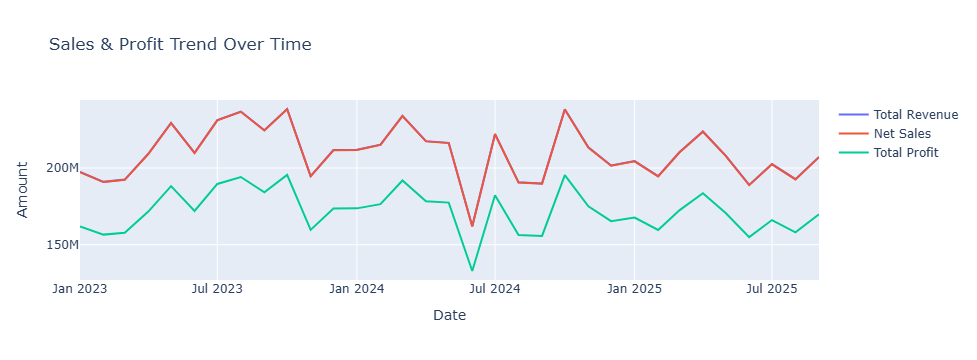

In [31]:
import pandas as pd
import plotly.graph_objects as go

# Read the CSV with the correct encoding
# Assuming the file loaded successfully from the previous step
df = pd.read_csv('E-COMMERCE_DATASET_BY_DJMW.csv', encoding='cp1252')

# Convert 'ORDER DATE' to datetime objects with the correct format
df['ORDER DATE'] = pd.to_datetime(df['ORDER DATE'], format="%d-%m-%Y")

# Now, the rest of your code for aggregation should work:
# Aggregate data by month
monthly_sales = df.groupby(df['ORDER DATE'].dt.to_period('M')).agg(
    total_revenue=('TOTAL REVENUE', 'sum'),
    net_sales=('NET SALES', 'sum'),
    total_profit=('PROFIT', 'sum')
).reset_index()

# Convert the period to a string for plotting
monthly_sales['ORDER DATE'] = monthly_sales['ORDER DATE'].astype(str)

# Create the interactive line chart using Plotly
fig = go.Figure()
fig.add_trace(go.Scatter(x=monthly_sales['ORDER DATE'], y=monthly_sales['total_revenue'], mode='lines', name='Total Revenue'))
fig.add_trace(go.Scatter(x=monthly_sales['ORDER DATE'], y=monthly_sales['net_sales'], mode='lines', name='Net Sales'))
fig.add_trace(go.Scatter(x=monthly_sales['ORDER DATE'], y=monthly_sales['total_profit'], mode='lines', name='Total Profit'))

fig.update_layout(title='Sales & Profit Trend Over Time',
                  xaxis_title='Date',
                  yaxis_title='Amount',
                  hovermode='x unified')
fig.show()

Overall Profit Margin: 82.00%


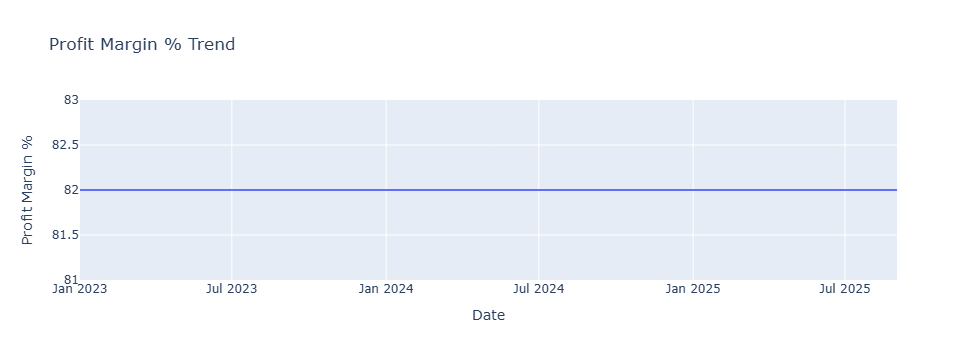

In [32]:
# Calculate the overall profit margin percentage
profit_margin_percentage = (df['PROFIT'].sum() / df['TOTAL REVENUE'].sum()) * 100
print(f"Overall Profit Margin: {profit_margin_percentage:.2f}%")

# Calculate monthly profit margin trend
monthly_sales['profit_margin'] = (monthly_sales['total_profit'] / monthly_sales['total_revenue']) * 100

# Create the interactive line chart for profit margin
fig_pm = go.Figure(data=go.Scatter(x=monthly_sales['ORDER DATE'], y=monthly_sales['profit_margin'], mode='lines', name='Profit Margin %'))

fig_pm.update_layout(title='Profit Margin % Trend',
                     xaxis_title='Date',
                     yaxis_title='Profit Margin %',
                     hovermode='x unified')
fig_pm.show()

## Customer Analysis 

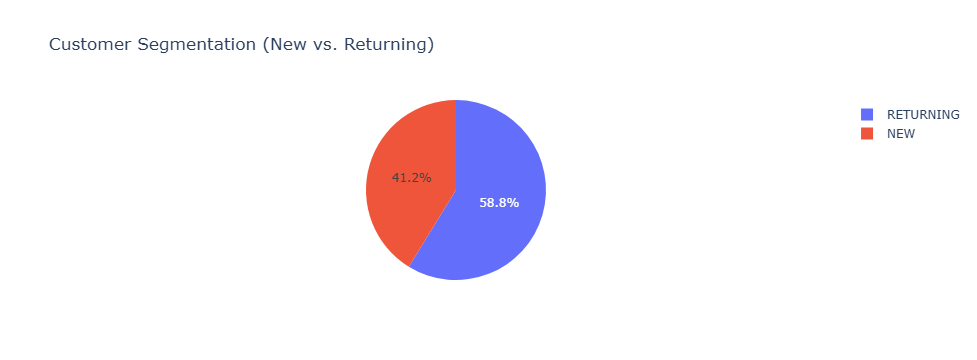

In [33]:
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt

# Assuming 'df' is your loaded DataFrame
# df = pd.read_csv('E-COMMERCE_DATASET_BY_DJMW.csv')

# Get the count of each customer type
customer_segmentation = df['CUSTOMER TYPE'].value_counts().reset_index()
customer_segmentation.columns = ['Customer Type', 'Count']

# Create a pie chart using Plotly
fig = px.pie(customer_segmentation, 
             values='Count', 
             names='Customer Type',
             title='Customer Segmentation (New vs. Returning)')
fig.show()

In [34]:
# Assuming 'REPEAT PURCHASE' column has 'Yes'/'No' or 1/0 values
# If not, you might need to convert it first.
# For example, if it's 'Yes'/'No':
# repeat_purchase_rate = (df['REPEAT PURCHASE'].value_counts()['Yes'] / len(df)) * 100

# A more robust way, assuming 1 for repeat purchase and 0 otherwise
# We can find unique customers who have repeated purchases.
total_customers = df['CUSTOMER NAME'].nunique()
repeat_customers = df[df['REPEAT PURCHASE'] == 1]['CUSTOMER NAME'].nunique()

# Calculate the rate
repeat_purchase_rate = (repeat_customers / total_customers) * 100

print(f"Repeat Purchase Rate: {repeat_purchase_rate:.2f}%")

Repeat Purchase Rate: 0.00%


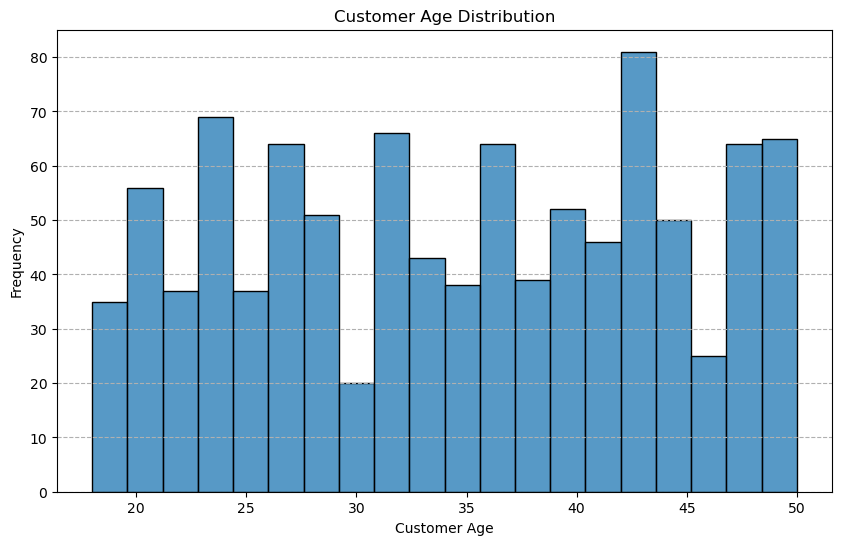

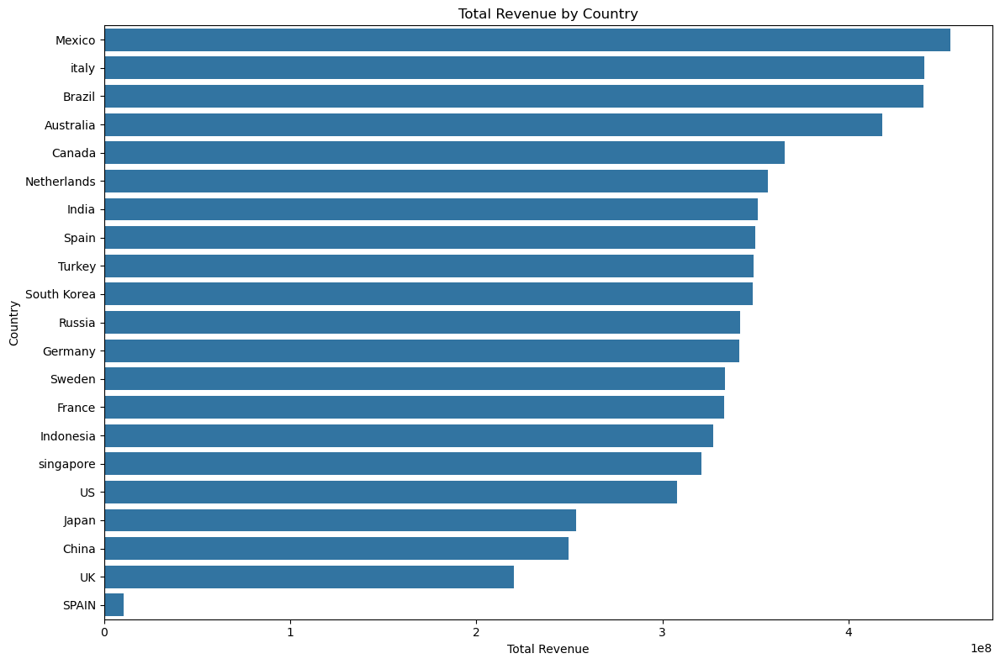

In [38]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the data with the correct encoding to handle potential errors
try:
    df = pd.read_csv('E-COMMERCE_DATASET_BY_DJMW.csv', encoding='cp1252')
except UnicodeDecodeError:
    df = pd.read_csv('E-COMMERCE_DATASET_BY_DJMW.csv', encoding='latin1')

# Clean column names by removing leading/trailing whitespace
df.columns = df.columns.str.strip()

# Convert 'CUSTOMER AGE' to a numeric type, coercing errors to NaN
df['CUSTOMER AGE'] = pd.to_numeric(df['CUSTOMER AGE'], errors='coerce')

# Drop rows with NaN values in 'CUSTOMER AGE' for accurate plotting
df.dropna(subset=['CUSTOMER AGE'], inplace=True)

# Corrected code for Customer Age Distribution (Histogram)
plt.figure(figsize=(10, 6))
sns.histplot(df['CUSTOMER AGE'], bins=20, kde=False)
plt.title('Customer Age Distribution')
plt.xlabel('Customer Age')
plt.ylabel('Frequency')
plt.grid(axis='y', linestyle='--')
plt.savefig('customer_age_distribution_histogram.png')

# Corrected code for Sales by Country (Bar chart as alternative to Choropleth)
# Aggregate sales by country
sales_by_country = df.groupby('COUNTRY')['TOTAL REVENUE'].sum().sort_values(ascending=False).reset_index()

plt.figure(figsize=(12, 8))
sns.barplot(data=sales_by_country, x='TOTAL REVENUE', y='COUNTRY', orient='h')
plt.title('Total Revenue by Country')
plt.xlabel('Total Revenue')
plt.ylabel('Country')
plt.tight_layout()
plt.savefig('total_revenue_by_country_bar_chart.png')

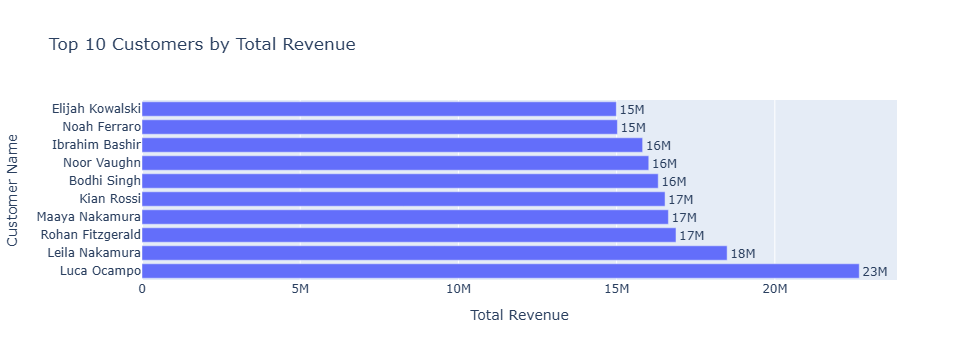

In [39]:
# Group by customer and sum their total revenue
top_customers = df.groupby('CUSTOMER NAME')['TOTAL REVENUE'].sum().nlargest(10).reset_index()
top_customers.columns = ['Customer Name', 'Total Revenue']

# Create a bar chart
fig = px.bar(top_customers,
             x='Total Revenue',
             y='Customer Name',
             orientation='h',
             title='Top 10 Customers by Total Revenue',
             text='Total Revenue')
fig.update_traces(texttemplate='%{text:,.2s}', textposition='outside')
fig.show()

## Product & Category Insights

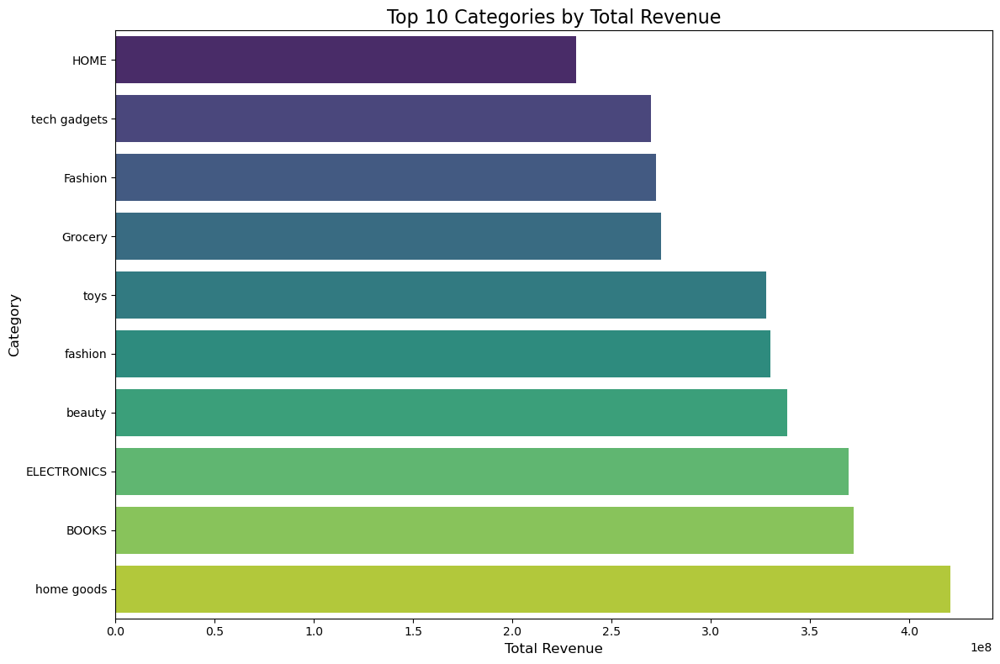

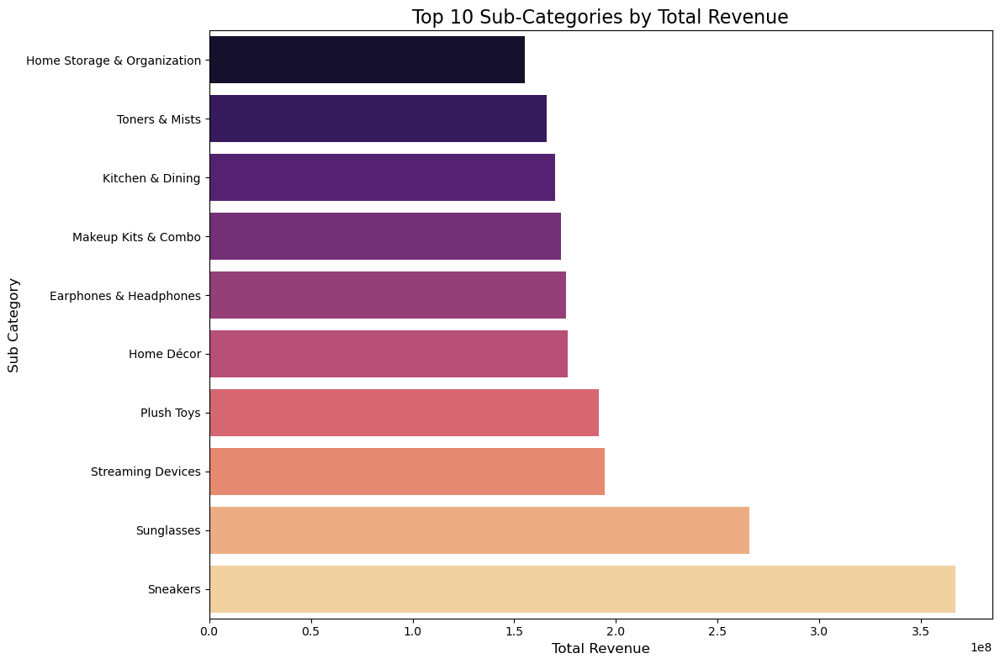

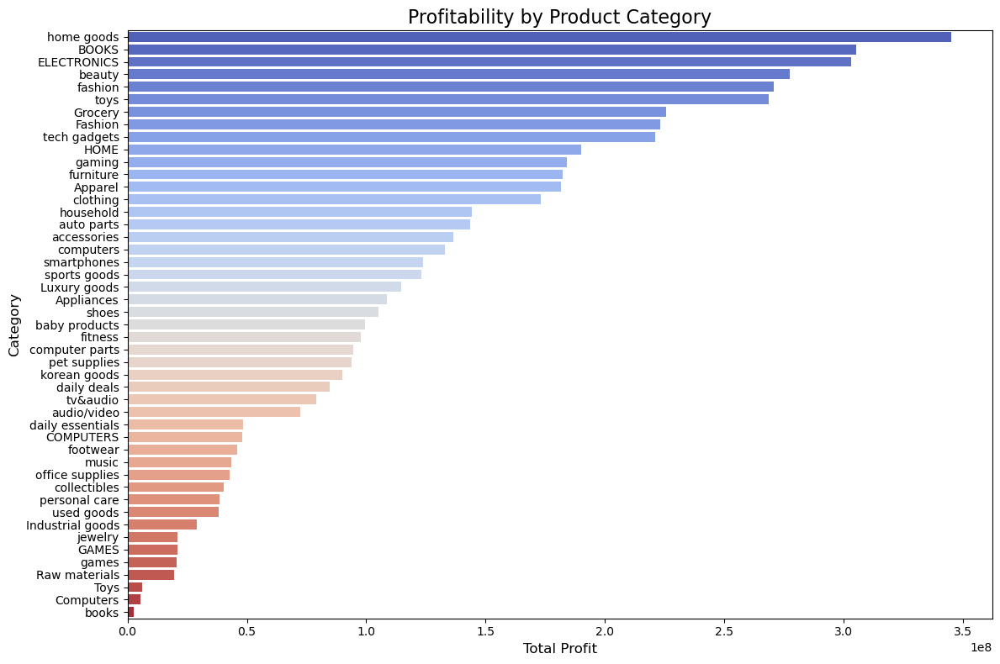

In [41]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df is already loaded and cleaned from the previous steps
# The code to load and clean the DataFrame is omitted for brevity

# --- Top 10 Categories by Total Revenue ---
# Calculate total revenue by category
top_categories = df.groupby('CATEGORY')['TOTAL REVENUE'].sum().nlargest(10).sort_values().reset_index()

# Corrected code for the bar chart
plt.figure(figsize=(12, 8))
sns.barplot(data=top_categories, x='TOTAL REVENUE', y='CATEGORY', hue='CATEGORY', orient='h', palette='viridis', legend=False)
plt.title('Top 10 Categories by Total Revenue', fontsize=16)
plt.xlabel('Total Revenue', fontsize=12)
plt.ylabel('Category', fontsize=12)
plt.tight_layout()
plt.show()

# --- Top 10 Sub-Categories by Total Revenue ---
top_sub_categories = df.groupby('SUB CATEGORY')['TOTAL REVENUE'].sum().nlargest(10).sort_values().reset_index()

# Corrected code for the bar chart
plt.figure(figsize=(12, 8))
sns.barplot(data=top_sub_categories, x='TOTAL REVENUE', y='SUB CATEGORY', hue='SUB CATEGORY', orient='h', palette='magma', legend=False)
plt.title('Top 10 Sub-Categories by Total Revenue', fontsize=16)
plt.xlabel('Total Revenue', fontsize=12)
plt.ylabel('Sub Category', fontsize=12)
plt.tight_layout()
plt.show()

# --- Profitability by Product Category ---
# Calculate total profit by category
profit_by_category = df.groupby('CATEGORY')['PROFIT'].sum().sort_values(ascending=False).reset_index()

# Corrected code for the bar chart
plt.figure(figsize=(12, 8))
sns.barplot(data=profit_by_category, x='PROFIT', y='CATEGORY', hue='CATEGORY', orient='h', palette='coolwarm', legend=False)
plt.title('Profitability by Product Category', fontsize=16)
plt.xlabel('Total Profit', fontsize=12)
plt.ylabel('Category', fontsize=12)
plt.tight_layout()
plt.show()

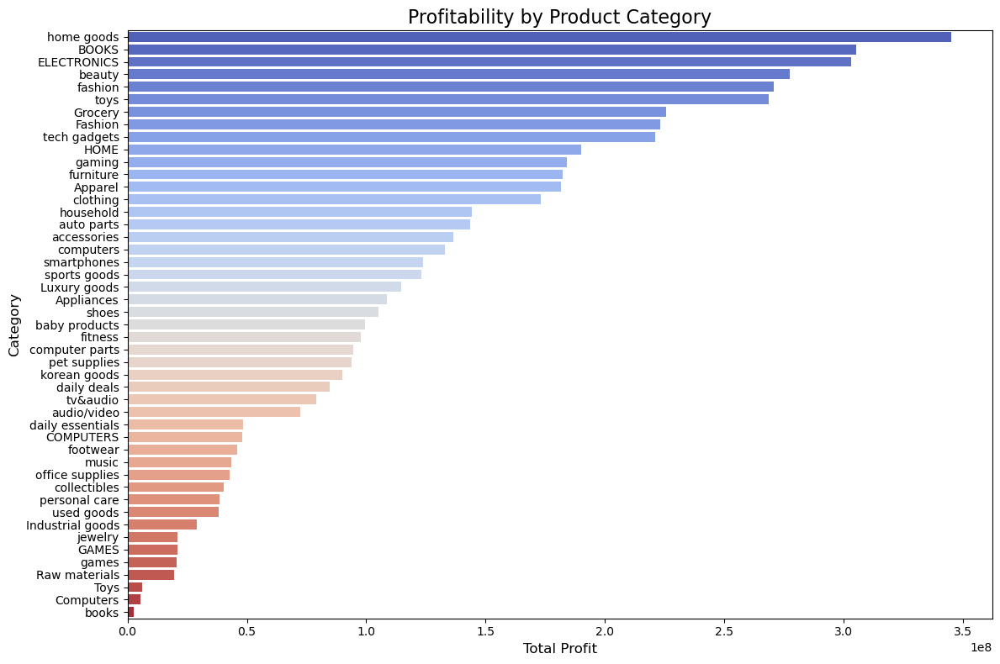

In [43]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df is already loaded and cleaned

# Calculate total profit by category
profit_by_category = df.groupby('CATEGORY')['PROFIT'].sum().sort_values(ascending=False).reset_index()

# Corrected code to avoid the FutureWarning
plt.figure(figsize=(12, 8))
sns.barplot(
    data=profit_by_category, 
    x='PROFIT', 
    y='CATEGORY', 
    hue='CATEGORY',  # Assign 'CATEGORY' to hue
    orient='h', 
    palette='coolwarm', 
    legend=False  # Hide the redundant legend
)
plt.title('Profitability by Product Category', fontsize=16)
plt.xlabel('Total Profit', fontsize=12)
plt.ylabel('Category', fontsize=12)
plt.tight_layout()
plt.show()

Overall Average Order Value (AOV): 34,962.08


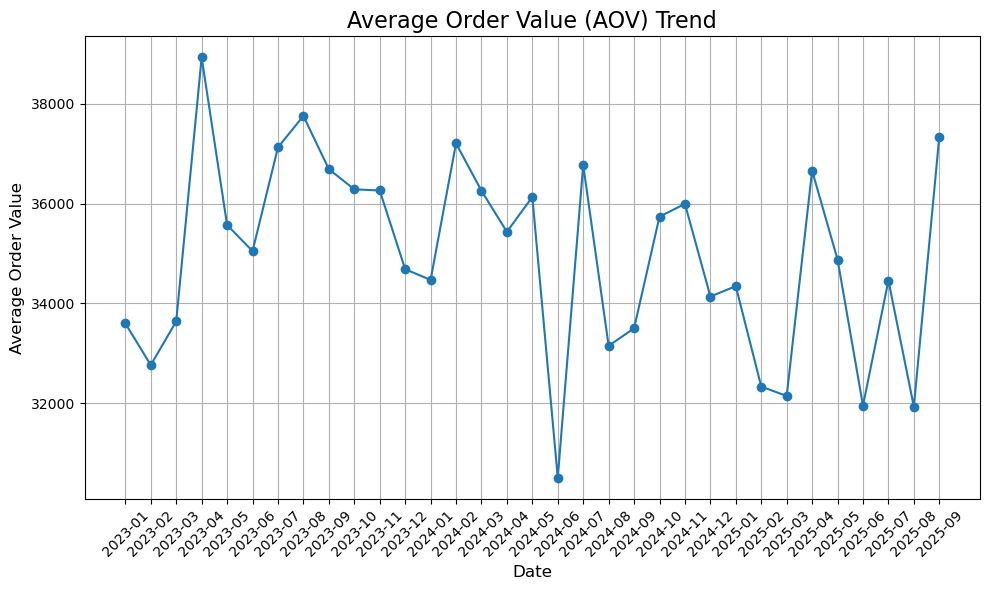

In [44]:
# Assuming 'AVERAGE ORDER VALUE' is a numeric column
overall_aov = df['AVERAGE ORDER VALUE'].mean()

# To get the AOV trend, we can group by date
df['ORDER DATE'] = pd.to_datetime(df['ORDER DATE'], format="%d-%m-%Y")
aov_trend = df.groupby(df['ORDER DATE'].dt.to_period('M'))['AVERAGE ORDER VALUE'].mean().reset_index()
aov_trend['ORDER DATE'] = aov_trend['ORDER DATE'].astype(str)

print(f"Overall Average Order Value (AOV): {overall_aov:,.2f}")

# Plot AOV trend
plt.figure(figsize=(10, 6))
plt.plot(aov_trend['ORDER DATE'], aov_trend['AVERAGE ORDER VALUE'], marker='o', linestyle='-')
plt.title('Average Order Value (AOV) Trend', fontsize=16)
plt.xlabel('Date', fontsize=12)
plt.ylabel('Average Order Value', fontsize=12)
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()

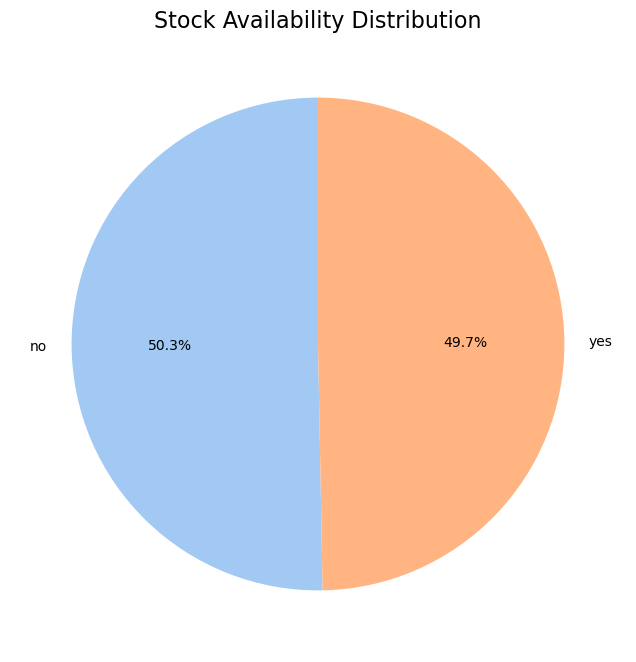

In [45]:
# Calculate stock availability count
stock_availability_count = df['STOCK AVAILIBILITY'].value_counts().reset_index()
stock_availability_count.columns = ['Status', 'Count']

# Plot the stock availability distribution
plt.figure(figsize=(8, 8))
plt.pie(stock_availability_count['Count'], labels=stock_availability_count['Status'], autopct='%1.1f%%', startangle=90, colors=sns.color_palette('pastel'))
plt.title('Stock Availability Distribution', fontsize=16)
plt.show()

## Marketing & Traffic Sources

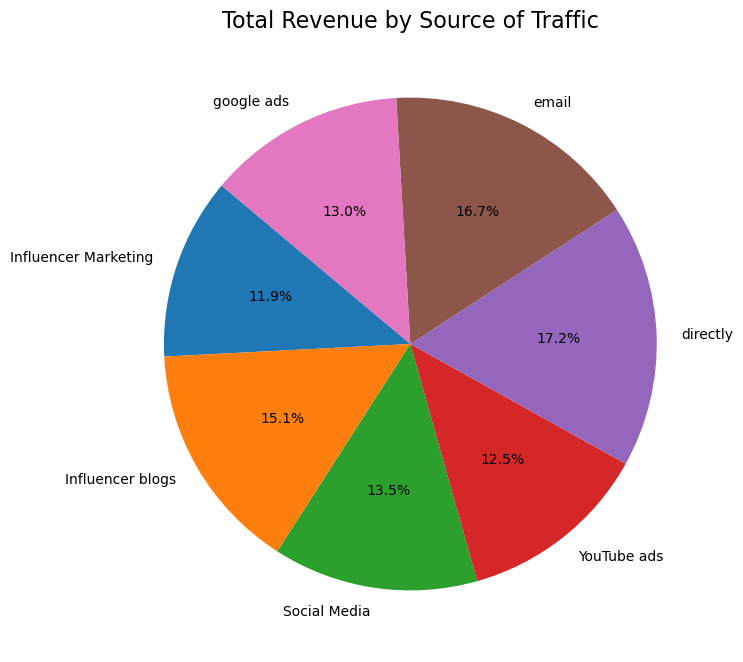

In [46]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming df is already loaded and cleaned from the previous steps
# Clean the 'SOURCE OF TRAFFIC' column by stripping whitespace
df.columns = df.columns.str.strip()

# Aggregate total revenue by traffic source
sales_by_traffic_source = df.groupby('SOURCE OF TRAFFIC')['TOTAL REVENUE'].sum().reset_index()

# Create a pie chart
plt.figure(figsize=(10, 8))
plt.pie(sales_by_traffic_source['TOTAL REVENUE'], labels=sales_by_traffic_source['SOURCE OF TRAFFIC'], autopct='%1.1f%%', startangle=140)
plt.title('Total Revenue by Source of Traffic', fontsize=16)
plt.show()

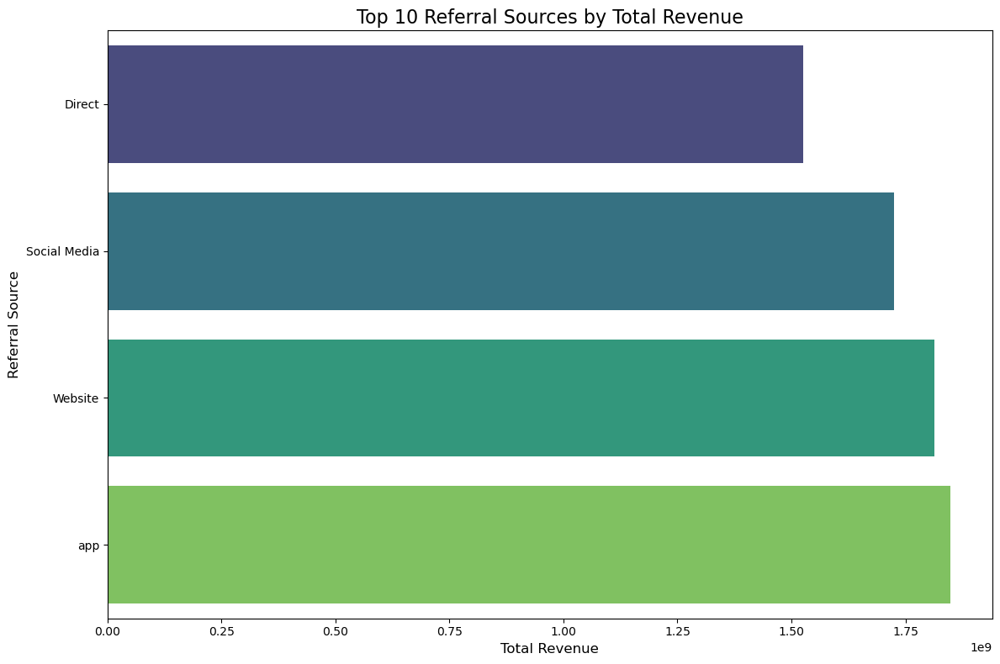

In [47]:
# Assuming 'REFERRAL SOURCE ' is a clean column name
df.columns = df.columns.str.strip()

# Aggregate total revenue by referral source
revenue_by_referral = df.groupby('REFERRAL SOURCE')['TOTAL REVENUE'].sum().nlargest(10).sort_values().reset_index()

# Create a bar chart
plt.figure(figsize=(12, 8))
sns.barplot(data=revenue_by_referral, x='TOTAL REVENUE', y='REFERRAL SOURCE', hue='REFERRAL SOURCE', orient='h', palette='viridis', legend=False)
plt.title('Top 10 Referral Sources by Total Revenue', fontsize=16)
plt.xlabel('Total Revenue', fontsize=12)
plt.ylabel('Referral Source', fontsize=12)
plt.tight_layout()
plt.show()

   COUPON USED  total_revenue  total_discount
0         True   6.912413e+09      5254800.15


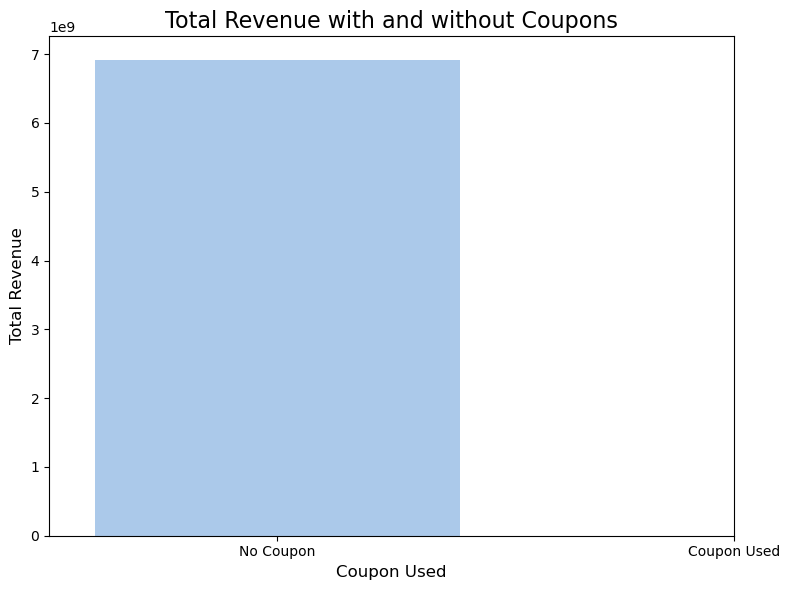

In [48]:
# Check if a coupon was used
df['COUPON USED'] = df['COUPON CODE USED'].notna()

# Aggregate sales and discount amount for transactions with and without a coupon
coupon_impact = df.groupby('COUPON USED').agg(
    total_revenue=('TOTAL REVENUE', 'sum'),
    total_discount=('DISCOUNT AMOUNT', 'sum')
).reset_index()

# Display the data
print(coupon_impact)

# Plot total revenue with and without coupons
plt.figure(figsize=(8, 6))
sns.barplot(data=coupon_impact, x='COUPON USED', y='total_revenue', hue='COUPON USED', palette='pastel', legend=False)
plt.title('Total Revenue with and without Coupons', fontsize=16)
plt.xlabel('Coupon Used', fontsize=12)
plt.ylabel('Total Revenue', fontsize=12)
plt.xticks([0, 1], ['No Coupon', 'Coupon Used'])
plt.tight_layout()
plt.show()

## Payment & Sales Channel Insights

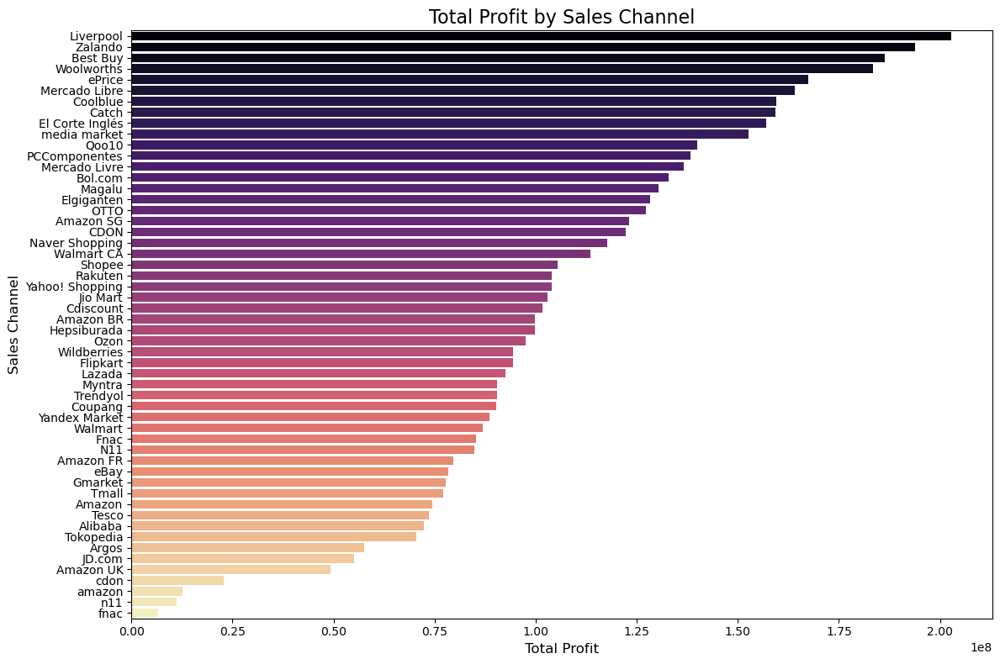

In [50]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df is already loaded and cleaned from the previous steps

# Aggregate total revenue and profit by sales channel
sales_channel_performance = df.groupby('SALES CHANNEL').agg(
    total_revenue=('TOTAL REVENUE', 'sum'),
    total_profit=('PROFIT', 'sum')
).reset_index()

# Sort by total revenue for better visualization
sales_channel_performance = sales_channel_performance.sort_values(by='total_revenue', ascending=False)

# Corrected code for the bar chart for total profit by sales channel
plt.figure(figsize=(12, 8))
sns.barplot(
    data=sales_channel_performance,
    x='total_profit',
    y='SALES CHANNEL',
    hue='SALES CHANNEL',
    orient='h',
    palette='magma',
    legend=False
)
plt.title('Total Profit by Sales Channel', fontsize=16)
plt.xlabel('Total Profit', fontsize=12)
plt.ylabel('Sales Channel', fontsize=12)
plt.tight_layout()
plt.show()

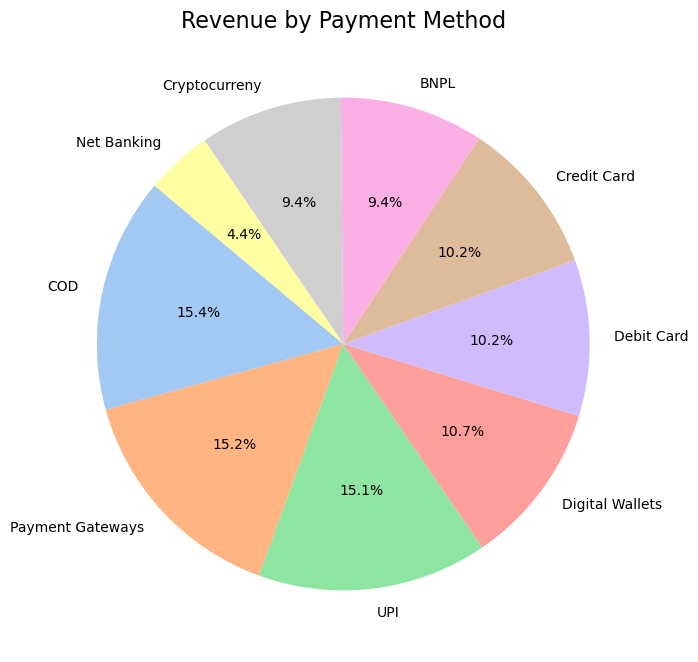

In [51]:
# Aggregate total revenue by payment method
payment_method_split = df.groupby('PAYMENT METHOD')['TOTAL REVENUE'].sum().reset_index()
payment_method_split = payment_method_split.sort_values(by='TOTAL REVENUE', ascending=False)

# Create a pie chart
plt.figure(figsize=(10, 8))
plt.pie(
    payment_method_split['TOTAL REVENUE'],
    labels=payment_method_split['PAYMENT METHOD'],
    autopct='%1.1f%%',
    startangle=140,
    colors=sns.color_palette('pastel')
)
plt.title('Revenue by Payment Method', fontsize=16)
plt.show()

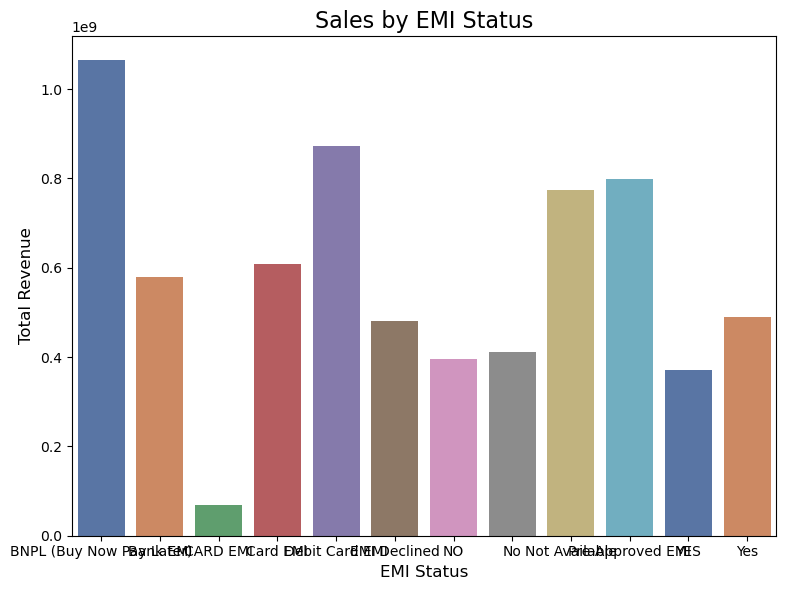

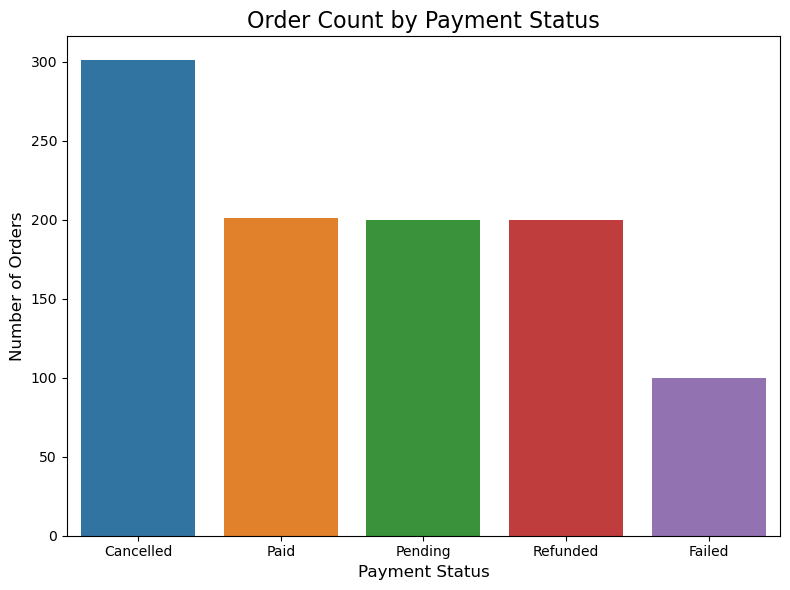

In [52]:
# Calculate sales by EMI status
emi_sales = df.groupby('EMI STATUS')['TOTAL REVENUE'].sum().reset_index()

# Plot sales by EMI status
plt.figure(figsize=(8, 6))
sns.barplot(
    data=emi_sales,
    x='EMI STATUS',
    y='TOTAL REVENUE',
    hue='EMI STATUS',
    palette='deep',
    legend=False
)
plt.title('Sales by EMI Status', fontsize=16)
plt.xlabel('EMI Status', fontsize=12)
plt.ylabel('Total Revenue', fontsize=12)
plt.tight_layout()
plt.show()

# Calculate payment status counts
payment_status_counts = df['PAYMENT STATUS'].value_counts().reset_index()
payment_status_counts.columns = ['Status', 'Count']

# Plot payment status counts
plt.figure(figsize=(8, 6))
sns.barplot(
    data=payment_status_counts,
    x='Status',
    y='Count',
    hue='Status',
    palette='tab10',
    legend=False
)
plt.title('Order Count by Payment Status', fontsize=16)
plt.xlabel('Payment Status', fontsize=12)
plt.ylabel('Number of Orders', fontsize=12)
plt.tight_layout()
plt.show()

##  Shipping & Operations

Overall Average Delivery Time: 4.00 days


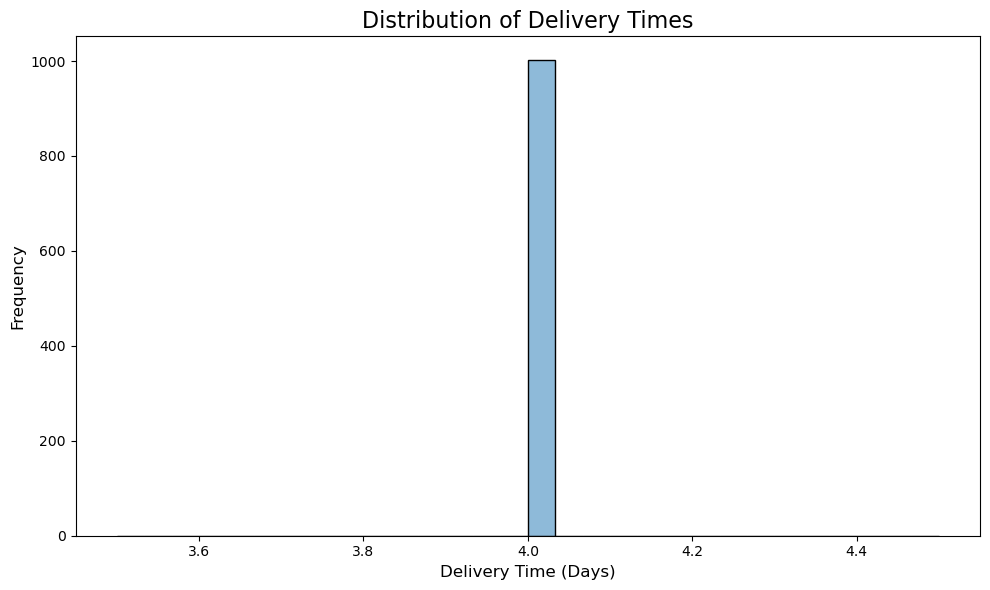

In [53]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df is already loaded and cleaned from the previous steps

# Ensure date columns are in datetime format for calculation
df['ORDER DATE'] = pd.to_datetime(df['ORDER DATE'], format="%d-%m-%Y", errors='coerce')
df['DELIVERY DATE'] = pd.to_datetime(df['DELIVERY DATE'], format="%d-%m-%Y", errors='coerce')

# Calculate delivery time in days
df['DELIVERY TIME (DAYS)'] = (df['DELIVERY DATE'] - df['ORDER DATE']).dt.days

# Calculate the average delivery time
avg_delivery_time = df['DELIVERY TIME (DAYS)'].mean()
print(f"Overall Average Delivery Time: {avg_delivery_time:.2f} days")

# Plot the distribution of delivery times
plt.figure(figsize=(10, 6))
sns.histplot(df['DELIVERY TIME (DAYS)'].dropna(), bins=30, kde=True)
plt.title('Distribution of Delivery Times', fontsize=16)
plt.xlabel('Delivery Time (Days)', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.tight_layout()
plt.show()

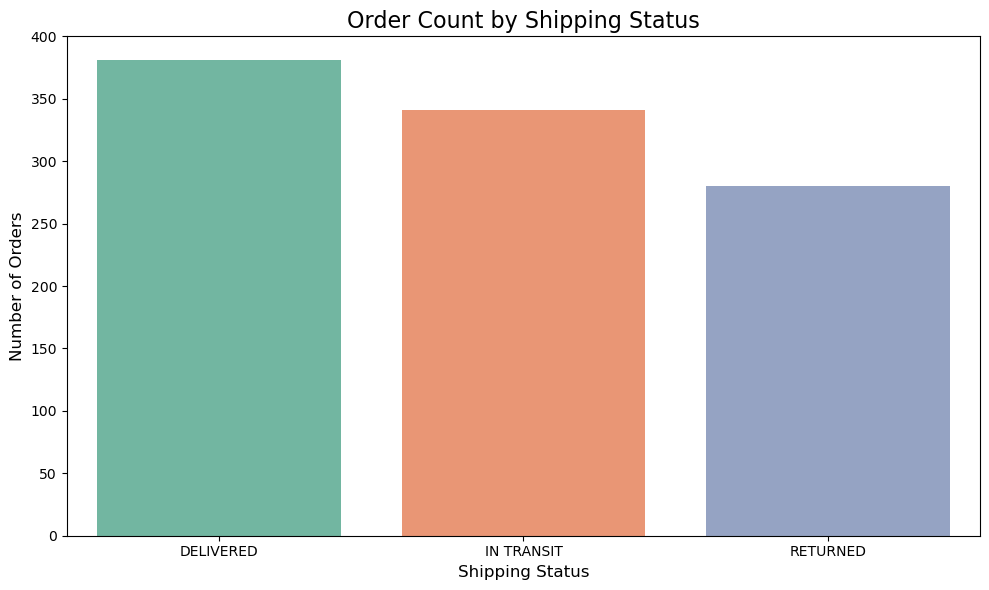

In [54]:
# Get the count of each shipping status
shipping_status_counts = df['SHIPPING STATUS'].value_counts().reset_index()
shipping_status_counts.columns = ['Status', 'Count']

# Create a bar chart for shipping status counts
plt.figure(figsize=(10, 6))
sns.barplot(
    data=shipping_status_counts,
    x='Status',
    y='Count',
    hue='Status',
    palette='Set2',
    legend=False
)
plt.title('Order Count by Shipping Status', fontsize=16)
plt.xlabel('Shipping Status', fontsize=12)
plt.ylabel('Number of Orders', fontsize=12)
plt.tight_layout()
plt.show()

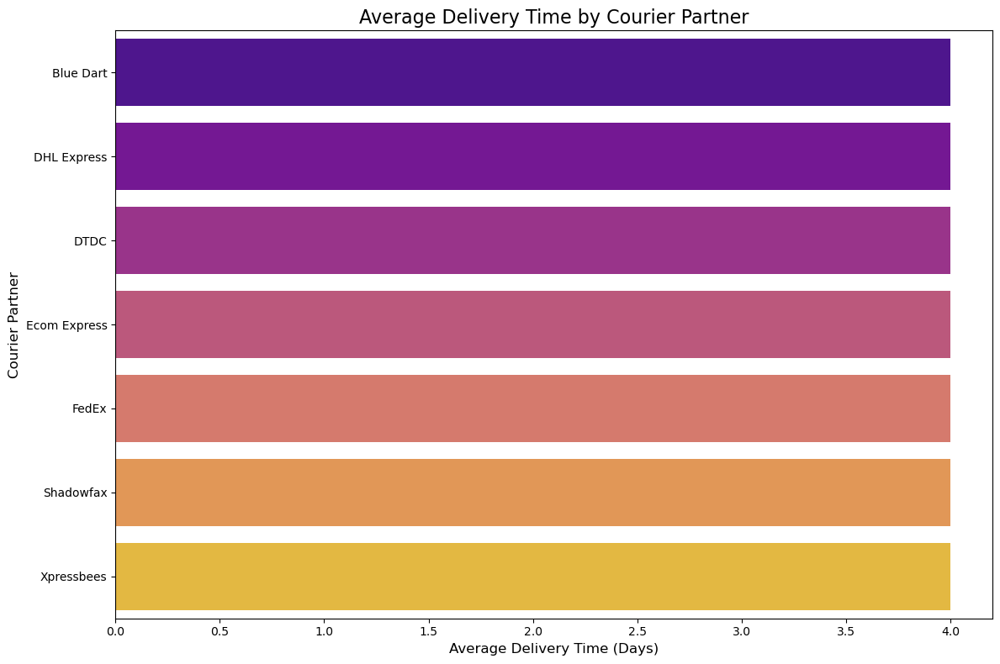

In [55]:
# Calculate average delivery time per courier partner
courier_performance = df.groupby('COURIER PARTNER')['DELIVERY TIME (DAYS)'].mean().sort_values().reset_index()

# Create a bar chart for courier performance
plt.figure(figsize=(12, 8))
sns.barplot(
    data=courier_performance,
    x='DELIVERY TIME (DAYS)',
    y='COURIER PARTNER',
    hue='COURIER PARTNER',
    orient='h',
    palette='plasma',
    legend=False
)
plt.title('Average Delivery Time by Courier Partner', fontsize=16)
plt.xlabel('Average Delivery Time (Days)', fontsize=12)
plt.ylabel('Courier Partner', fontsize=12)
plt.tight_layout()
plt.show()

In [56]:
# Calculate the total shipping amount
total_shipping_amount = df['SHIPPING AMOUNT'].sum()
print(f"Total Shipping Amount: {total_shipping_amount:,.2f}")

# Compare average shipping amount to AOV and Profit
avg_shipping_amount = df['SHIPPING AMOUNT'].mean()
avg_aov = df['AVERAGE ORDER VALUE'].mean()
avg_profit = df['PROFIT'].mean()

print(f"Average Shipping Amount per Order: {avg_shipping_amount:,.2f}")
print(f"Average Order Value (AOV): {avg_aov:,.2f}")
print(f"Average Profit per Order: {avg_profit:,.2f}")

# You can use a grouped bar chart or a custom plot to visualize the comparison if needed.

Total Shipping Amount: 350,320.01
Average Shipping Amount per Order: 349.62
Average Order Value (AOV): 34,962.08
Average Profit per Order: 5,656,864.53


## Customer Feedback & Satisfaction

Overall Average Rating: 2.85 out of 5


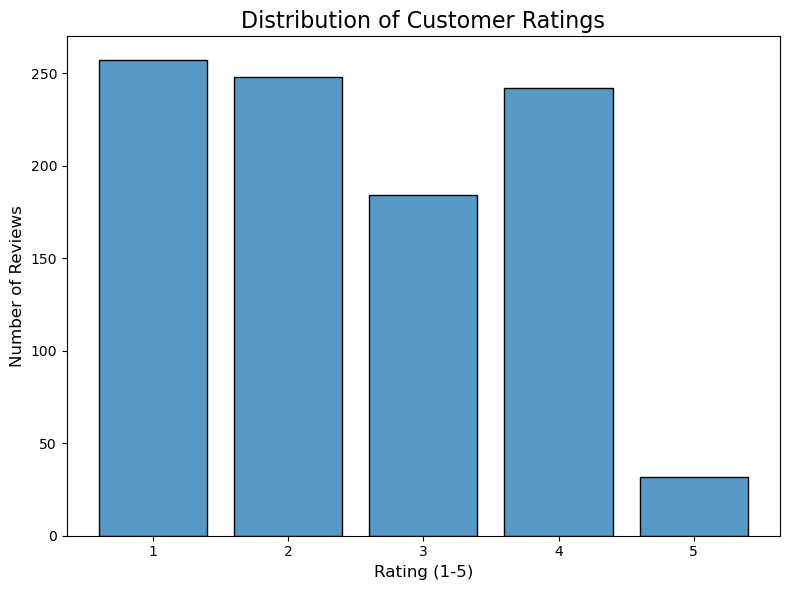

In [58]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df is already loaded and cleaned from the previous steps
# Clean the 'RATING' column by converting it to a numeric data type
df['RATING'] = pd.to_numeric(df['RATING'], errors='coerce')

# Calculate the overall average rating
avg_rating = df['RATING'].mean()
print(f"Overall Average Rating: {avg_rating:.2f} out of 5")

# Plot the distribution of ratings
plt.figure(figsize=(8, 6))
sns.histplot(df['RATING'].dropna(), bins=[1, 2, 3, 4, 5, 6], kde=False, shrink=0.8)
plt.title('Distribution of Customer Ratings', fontsize=16)
plt.xlabel('Rating (1-5)', fontsize=12)
plt.ylabel('Number of Reviews', fontsize=12)
plt.xticks(ticks=[1.5, 2.5, 3.5, 4.5, 5.5], labels=['1', '2', '3', '4', '5'])
plt.tight_layout()
plt.show()

In [61]:
!pip install nltk
!pip install wordcloud

In [63]:
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\21265\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping corpora\stopwords.zip.


True

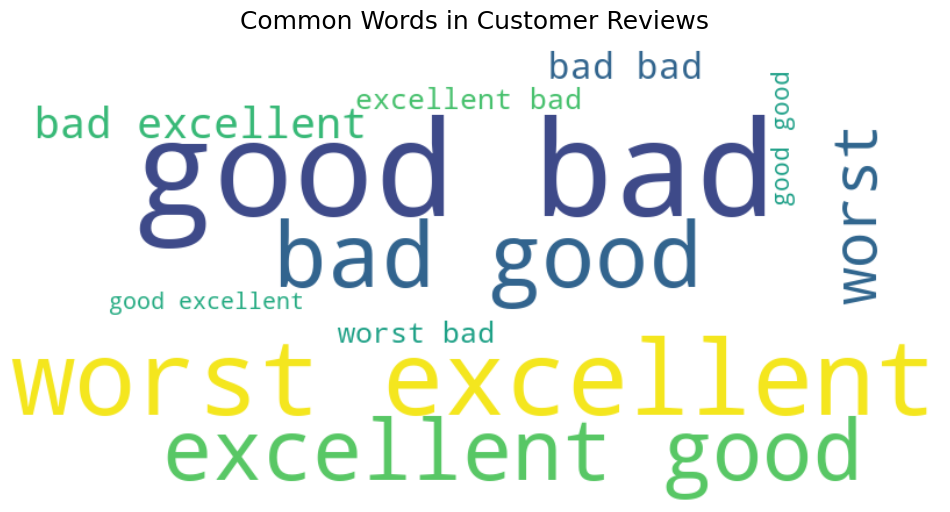

The 'textblob' library is not installed. Please install it to run sentiment analysis.


In [65]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import nltk
from wordcloud import WordCloud
import re

# Assuming 'df' is your loaded and cleaned DataFrame from previous steps

# Drop any rows with missing review comments
reviews = df.dropna(subset=['CUSTOMER REVIEW COMMENT'])
all_comments = ' '.join(reviews['CUSTOMER REVIEW COMMENT']).lower()

# Clean the text (remove special characters, numbers, etc.)
clean_comments = re.sub(r'[^a-z\s]', '', all_comments)

# Create a list of words from the clean comments
words = clean_comments.split()

# Remove common "stopwords"
stopwords = set(nltk.corpus.stopwords.words('english'))
filtered_words = [word for word in words if word not in stopwords and len(word) > 2]

# Create a Word Cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(' '.join(filtered_words))

plt.figure(figsize=(12, 8))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Common Words in Customer Reviews', fontsize=18)
plt.show()

# --- Optional: Basic Sentiment Analysis ---
# You need to install the 'textblob' library for this part to work.
# Run this command in a cell: !pip install textblob
# And download the 'punkt' and 'sentiment' resources from nltk.
# import nltk
# nltk.download('punkt')
# nltk.download('averaged_perceptron_tagger')

try:
    from textblob import TextBlob

    # Apply sentiment analysis to each review
    sentiment_scores = reviews['CUSTOMER REVIEW COMMENT'].apply(lambda x: TextBlob(str(x)).sentiment.polarity)

    print(f"Average Sentiment Polarity: {sentiment_scores.mean():.2f}")

    # Plotting a histogram of sentiment scores
    plt.figure(figsize=(8, 6))
    sns.histplot(sentiment_scores, bins=20, kde=True)
    plt.title('Distribution of Sentiment Scores', fontsize=16)
    plt.xlabel('Sentiment Polarity (-1 to 1)', fontsize=12)
    plt.ylabel('Frequency', fontsize=12)
    plt.show()

except ImportError:
    print("The 'textblob' library is not installed. Please install it to run sentiment analysis.")